<a href="https://colab.research.google.com/github/23DEB/detection/blob/main/notebooks/zero-shot-object-detection-with-grounding-dino.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Roboflow Notebooks](https://media.roboflow.com/notebooks/template/bannertest2-2.png?ik-sdk-version=javascript-1.4.3&updatedAt=1672932710194)](https://github.com/roboflow/notebooks)

# Zero-Shot Object Detection with Grounding DINO

---

[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/zero-shot-object-detection-with-grounding-dino.ipynb) [![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/IDEA-Research/GroundingDINO) [![arXiv](https://img.shields.io/badge/arXiv-2303.05499-b31b1b.svg)](https://arxiv.org/abs/2303.05499)

Grounding DINO can detect **arbitrary objects** with human inputs such as category names or referring expressions. The key solution of open-set object detection is introducing language to a closed-set detector DINO. for open-set concept generalization. If you want to learn more visit official GitHub [repository](https://github.com/IDEA-Research/GroundingDINO) and read the [paper](https://arxiv.org/abs/2303.05499).

![grounding dino figure](https://media.roboflow.com/notebooks/examples/grounding-dino-figure.png)

## Complementary Materials

---

[![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/grounding-dino-zero-shot-object-detection) [![YouTube](https://badges.aleen42.com/src/youtube.svg)](https://youtu.be/cMa77r3YrDk)

We recommend that you follow along in this notebook while reading the blog post on Grounding DINO. We will talk about the advantages of Grounding DINO, analyze the model architecture, and provide real prompt examples.

![grounding dino](https://media.roboflow.com/notebooks/examples/grounding-dino.png)

## ⚠️ Disclaimer

Grounding DINO codebase is still under development. If you experience any problems with launching the notebook, please let us know and create [issues](https://github.com/roboflow/notebooks/issues) on our GitHub.

## Pro Tip: Use GPU Acceleration

If you are running this notebook in Google Colab, navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`. This will ensure your notebook uses a GPU, which will significantly speed up model training times.

## Steps in this Tutorial

In this tutorial, we are going to cover:

- Before you start
- Install Grounding DINO 🦕
- Download Grounding DINO Weights 🏋️
- Download Example Data
- Load Grounding DINO Model
- Grounding DINO Demo
- Grounding DINO with Roboflow Dataset
- 🏆 Congratulations

**Let's begin!**

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [2]:
!nvidia-smi

Fri Dec  6 06:04:51 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P8              12W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
import os
HOME = os.getcwd()
print(HOME)

/content


## Install Grounding DINO 🦕

In [4]:
%cd {HOME}
!git clone https://github.com/IDEA-Research/GroundingDINO.git
%cd {HOME}/GroundingDINO
!pip install -q -e .
!pip install -q roboflow

/content
Cloning into 'GroundingDINO'...
remote: Enumerating objects: 463, done.
remote: Counting objects: 100% (240/240), done.
remote: Compressing objects: 100% (103/103), done.
remote: Total 463 (delta 176), reused 137 (delta 137), pack-reused 223 (from 1)
Receiving objects: 100% (463/463), 12.87 MiB | 17.72 MiB/s, done.
Resolving deltas: 100% (241/241), done.
/content/GroundingDINO
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.8/46.8 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 256.2/256.2 kB 21.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.9/80.9 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.2 MB/s eta 0:00:00


In [5]:
import os

CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
print(CONFIG_PATH, "; exist:", os.path.isfile(CONFIG_PATH))

/content/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py ; exist: True


## Download Grounding DINO Weights 🏋️

In [6]:
%cd {HOME}
!mkdir {HOME}/weights
%cd {HOME}/weights

!wget -q https://github.com/IDEA-Research/GroundingDINO/releases/download/v0.1.0-alpha/groundingdino_swint_ogc.pth

/content
/content/weights


In [7]:
import os

WEIGHTS_NAME = "groundingdino_swint_ogc.pth"
WEIGHTS_PATH = os.path.join(HOME, "weights", WEIGHTS_NAME)
print(WEIGHTS_PATH, "; exist:", os.path.isfile(WEIGHTS_PATH))

/content/weights/groundingdino_swint_ogc.pth ; exist: True


## Download Example Data

In [8]:
%cd {HOME}
!mkdir {HOME}/data
%cd {HOME}/data

!wget -q https://media.roboflow.com/notebooks/examples/dog.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-2.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-3.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-4.jpeg

/content
/content/data


## Load Grounding DINO Model

In [9]:
%cd {HOME}/GroundingDINO

from groundingdino.util.inference import load_model, load_image, predict, annotate

model = load_model(CONFIG_PATH, WEIGHTS_PATH)

/content/GroundingDINO


final text_encoder_type: bert-base-uncased


The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

## Grounding DINO Demo

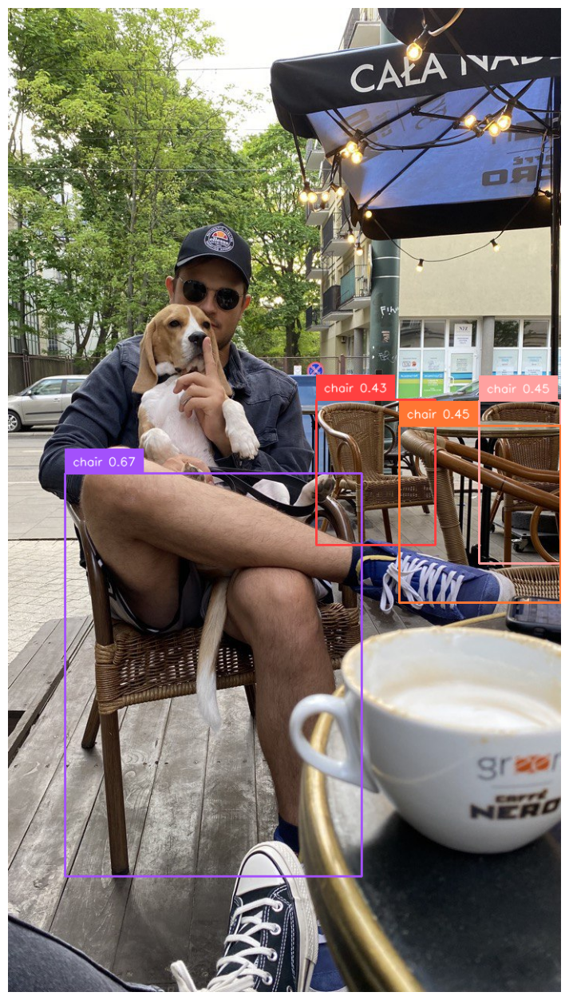

In [10]:
import os
import supervision as sv

IMAGE_NAME = "dog-3.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "chair"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

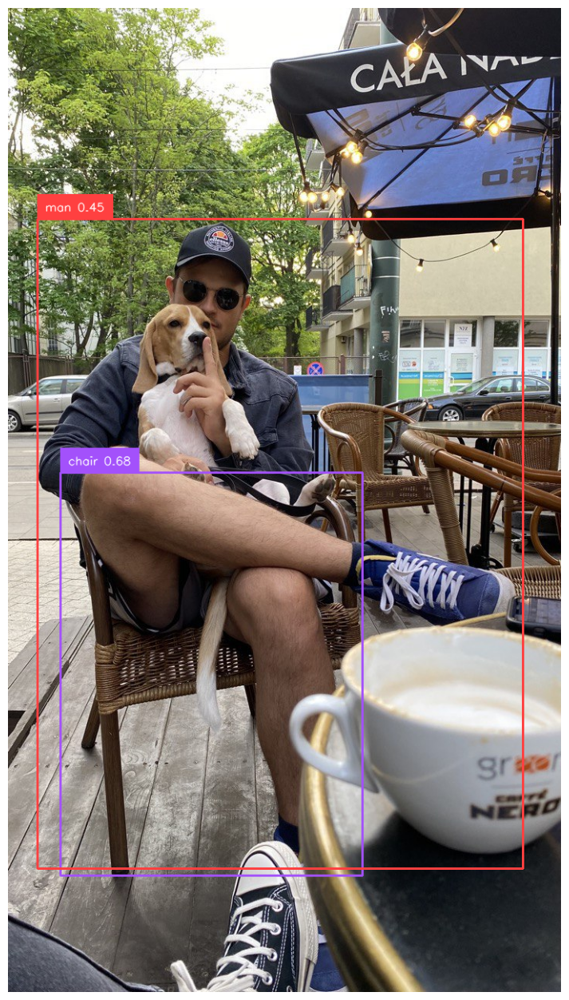

In [11]:
import os
import supervision as sv

IMAGE_NAME = "dog-3.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "chair with man sitting on it"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

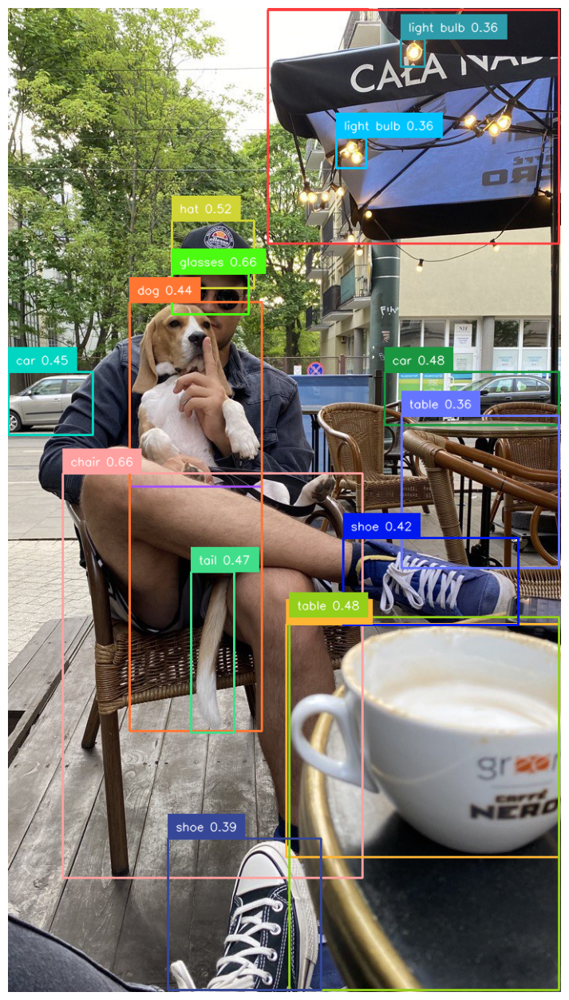

In [12]:
import os
import supervision as sv

IMAGE_NAME = "dog-3.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "chair, dog, table, shoe, light bulb, coffee, hat, glasses, car, tail, umbrella"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

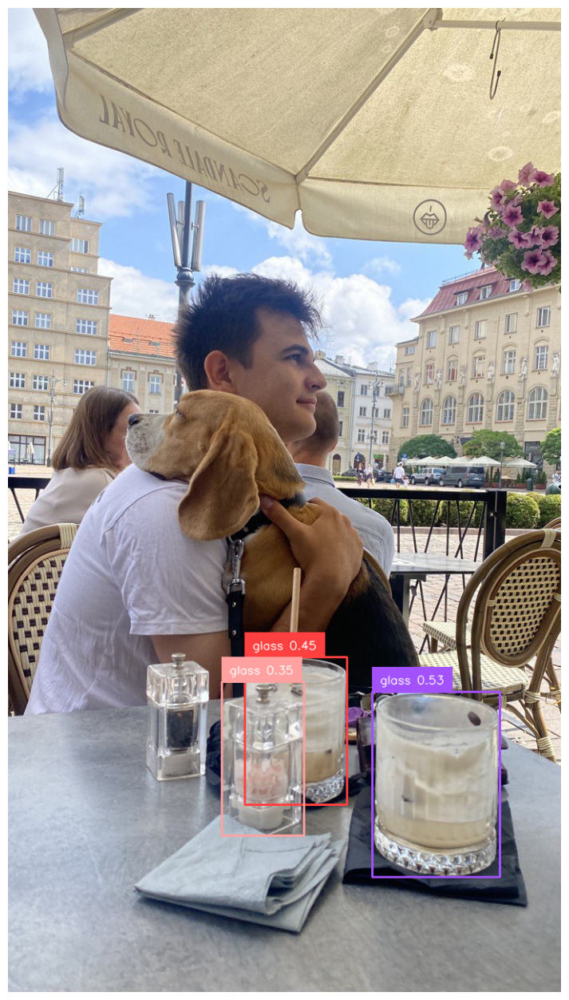

In [13]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "glass"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

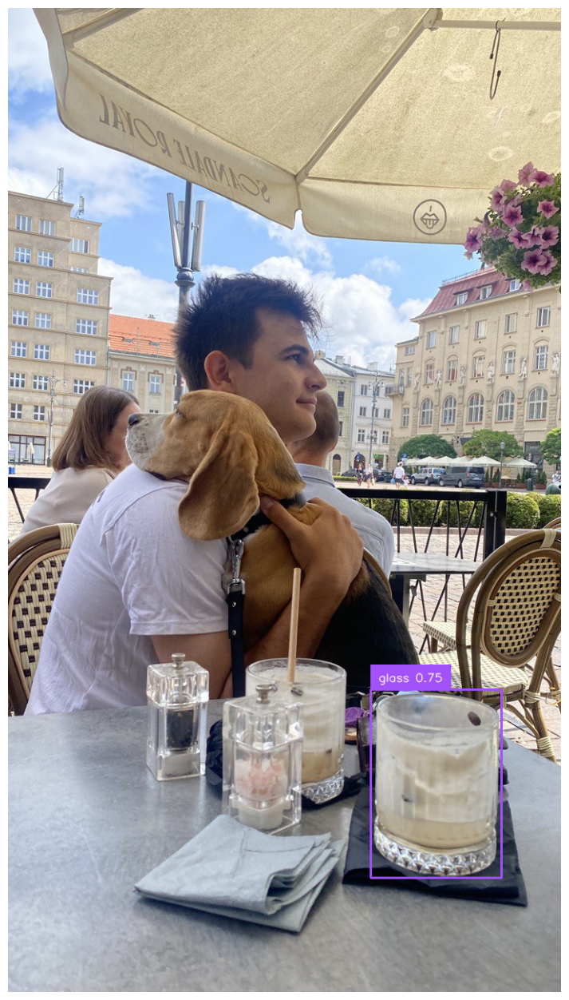

In [14]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "glass most to the right"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

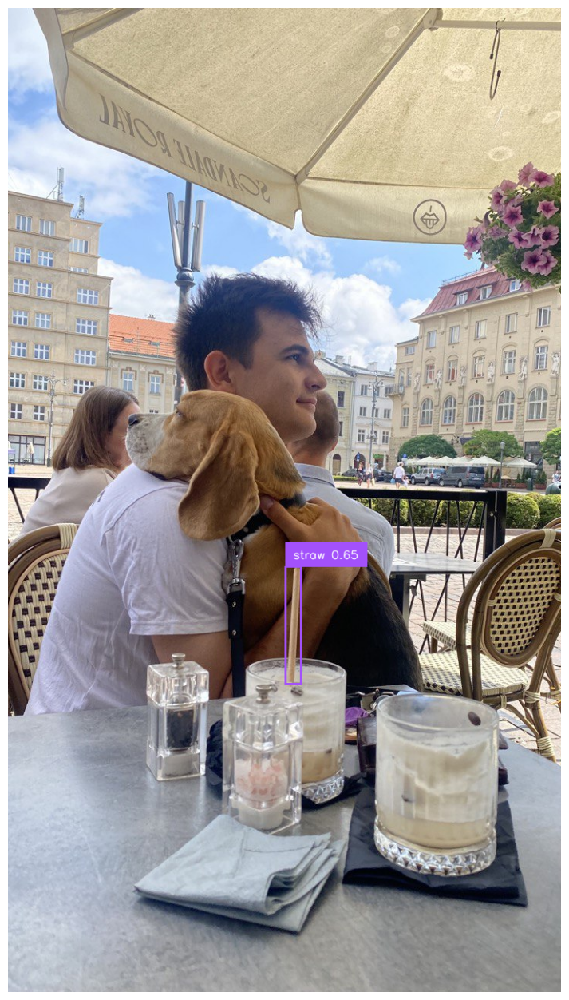

In [15]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "straw"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

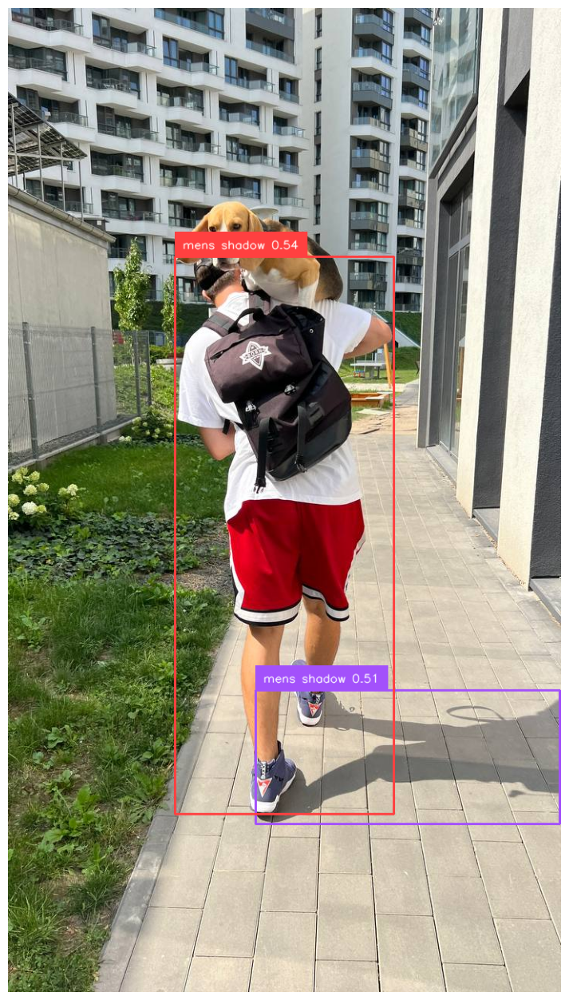

In [16]:
import os
import supervision as sv

IMAGE_NAME = "dog-4.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "mens shadow"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

## Grounding DINO with Roboflow Dataset

In [17]:
%cd {HOME}

/content


In [20]:
  import roboflow

roboflow.login()

visit https://app.roboflow.com/auth-cli to get your authentication token.
Paste the authentication token here: ··········


In [21]:
from random import randrange
from roboflow.core.dataset import Dataset


def pick_random_image(dataset: Dataset, subdirrectory: str = "valid") -> str:
    image_directory_path = f"{dataset.location}/{subdirrectory}"
    image_names = os.listdir(image_directory_path)
    image_index = randrange(len(image_names))
    image_name = image_names[image_index]
    image_path = os.path.join(image_directory_path, image_name)
    return image_path

In [22]:
from roboflow import Roboflow
rf = Roboflow()
project = rf.workspace("work-safe-project").project("safety-vest---v4")
dataset = project.version(3).download("coco")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Safety-vest---v4-3 in coco:: 100%|██████████| 438/438 [00:00<00:00, 3896.66it/s]


In [23]:
TEXT_PROMPT = ", ".join(project.classes.keys())
TEXT_PROMPT

'reflective, not_helmet, helmet, not_reflective'

In [50]:
image_path = "/content/factory.jpg"

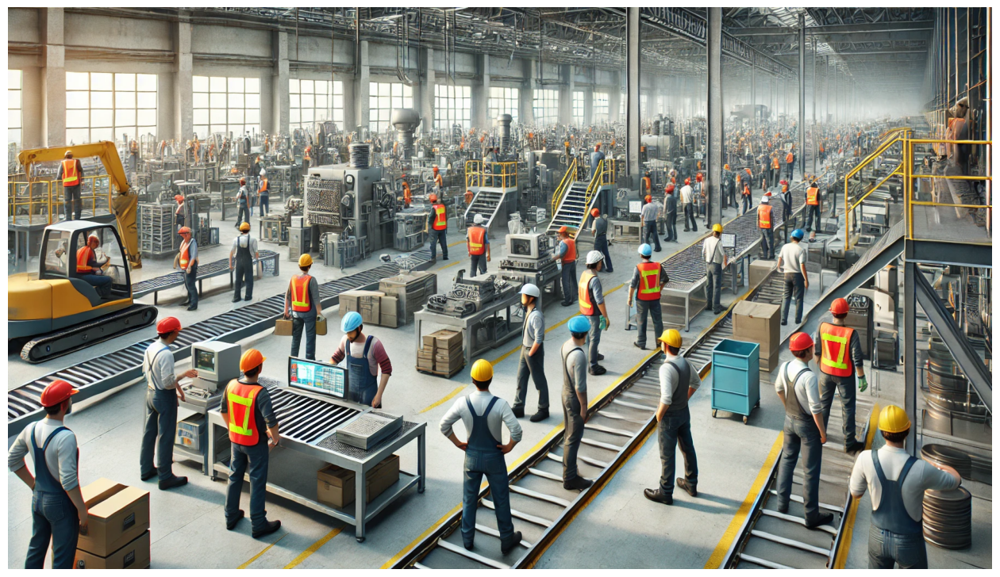

In [51]:
import os
import supervision as sv

BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(image_path)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

**NOTE:** The design of the prompt is very important. Try to be as accurate as possible. Avoid abbreviations.

In [55]:
TEXT_PROMPT = "reflective safety vest, helmet, head, nonreflective safety vest"

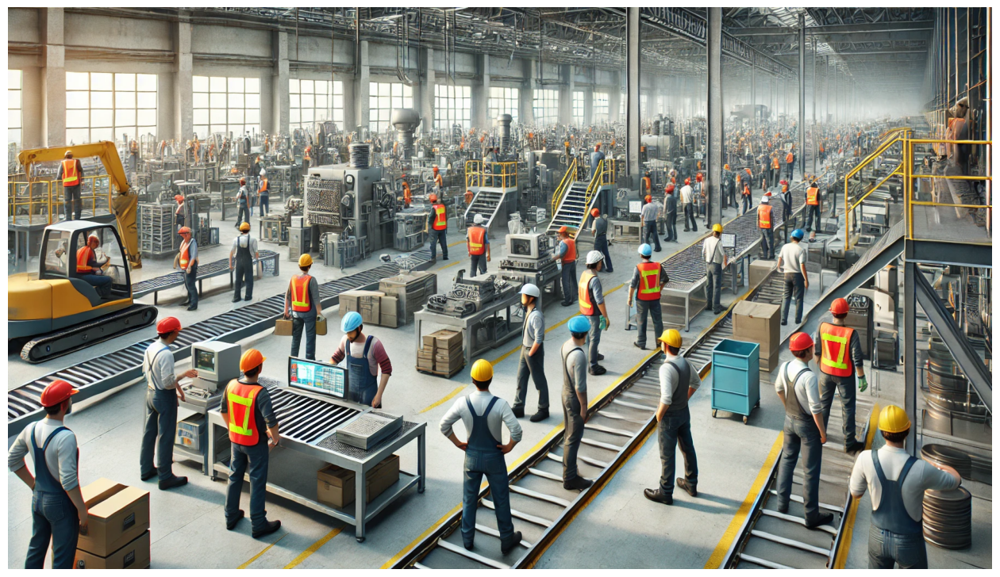

In [67]:
import os
import supervision as sv

BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(image_path)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

final text_encoder_type: bert-base-uncased


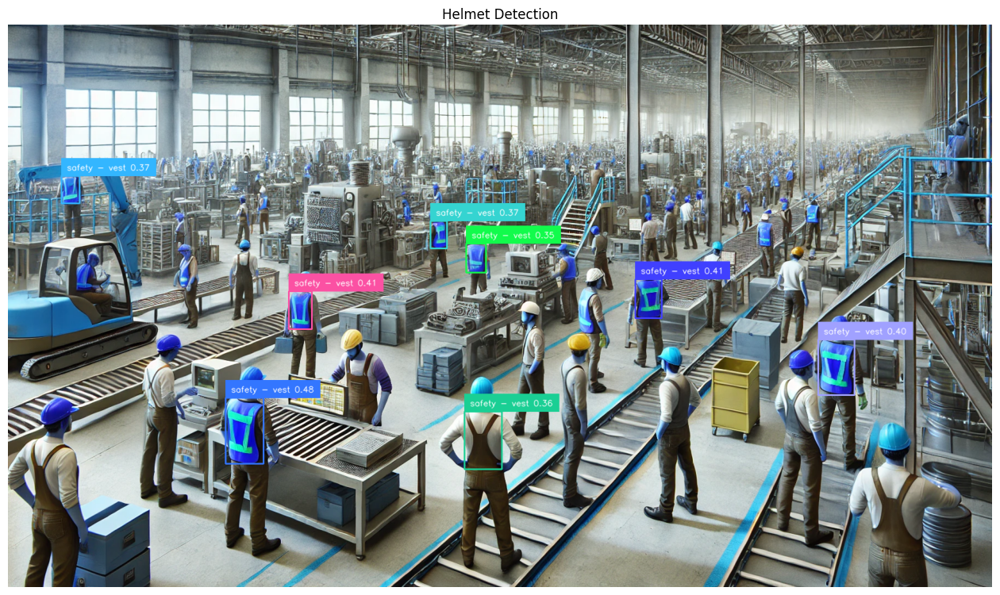

Detected: safety - vest at tensor([0.2971, 0.5082, 0.0231, 0.0674])
Detected: safety - vest at tensor([0.6509, 0.4875, 0.0271, 0.0699])
Detected: safety - vest at tensor([0.8417, 0.6090, 0.0369, 0.0985])
Detected: safety - vest at tensor([0.2403, 0.7221, 0.0384, 0.1171])
Detected: safety - vest at tensor([0.0636, 0.2939, 0.0185, 0.0487])
Detected: safety - vest at tensor([0.4379, 0.3734, 0.0164, 0.0494])
Detected: safety - vest at tensor([0.4756, 0.4153, 0.0202, 0.0518])
Detected: safety - vest at tensor([0.4830, 0.7391, 0.0384, 0.1031])


In [72]:
import os
import matplotlib.pyplot as plt
from groundingdino.util.inference import load_model, load_image, predict, annotate

# Define paths for configuration and weights
CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
WEIGHTS_PATH = os.path.join(HOME, "weights", "groundingdino_swint_ogc.pth")

# Load the Grounding DINO model
model = load_model(CONFIG_PATH, WEIGHTS_PATH)

# Define the uploaded image path (update path if needed)
image_path = "/content/factory.jpg"

# Define the text prompt
TEXT_PROMPT = "safety-vest"
BOX_THRESHOLD = 0.35  # Detection confidence threshold for bounding boxes
TEXT_THRESHOLD = 0.25  # Text matching confidence threshold

# Load the image
image_source, image = load_image(image_path)

# Perform prediction using Grounding DINO
boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_THRESHOLD,
    text_threshold=TEXT_THRESHOLD
)

# Annotate the image with predictions
annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

# Plot the annotated image
plt.figure(figsize=(16, 16))
plt.imshow(annotated_frame)
plt.axis("off")
plt.title("Helmet Detection")
plt.show()

# Print detected phrases and their bounding boxes
for phrase, box in zip(phrases, boxes):
    print(f"Detected: {phrase} at {box}")


In [58]:
TEXT_PROMPT = "construction helmet, safety helmet, hard hat"


In [59]:
BOX_THRESHOLD = 0.2  # Lower for higher sensitivity
TEXT_THRESHOLD = 0.15


In [60]:
def filter_small_boxes(boxes, min_size=50):
    """Filter out bounding boxes smaller than min_size."""
    filtered_boxes = [box for box in boxes if (box[2] - box[0]) > min_size and (box[3] - box[1]) > min_size]
    return filtered_boxes

# Apply filter to the detected boxes
filtered_boxes = filter_small_boxes(detected_boxes, min_size=100)
print("Filtered Boxes:", filtered_boxes)


Filtered Boxes: []


In [61]:
def sliding_window_detection(image_path, model, text_prompt, window_size=(224, 224), step_size=50):
    """Perform helmet detection using sliding windows and Grounding DINO."""
    # Load the image
    image_source, image = load_image(image_path)
    original_image = image_source.copy()
    height, width = image.shape[:2]

    detected_boxes = []

    # Slide a window over the image
    for y in range(0, height - window_size[1] + 1, step_size):
        for x in range(0, width - window_size[0] + 1, step_size):
            # Extract the current window
            window = image[y:y+window_size[1], x:x+window_size[0]]

            # Perform prediction
            boxes, logits, phrases = predict(
                model=model,
                image=window,
                caption=text_prompt,
                box_threshold=0.3,
                text_threshold=0.2
            )

            # Adjust box coordinates to the original image scale
            for box in boxes:
                adjusted_box = [
                    box[0] + x, box[1] + y,
                    box[2] + x, box[3] + y
                ]
                detected_boxes.append(adjusted_box)

                # Draw the detected box on the original image
                cv2.rectangle(original_image,
                              (int(adjusted_box[0]), int(adjusted_box[1])),
                              (int(adjusted_box[2]), int(adjusted_box[3])),
                              (0, 255, 0), 2)

    # Plot the result
    plt.figure(figsize=(16, 16))
    plt.imshow(original_image)
    plt.axis("off")
    plt.title("Sliding Window Helmet Detection")
    plt.show()

    return detected_boxes


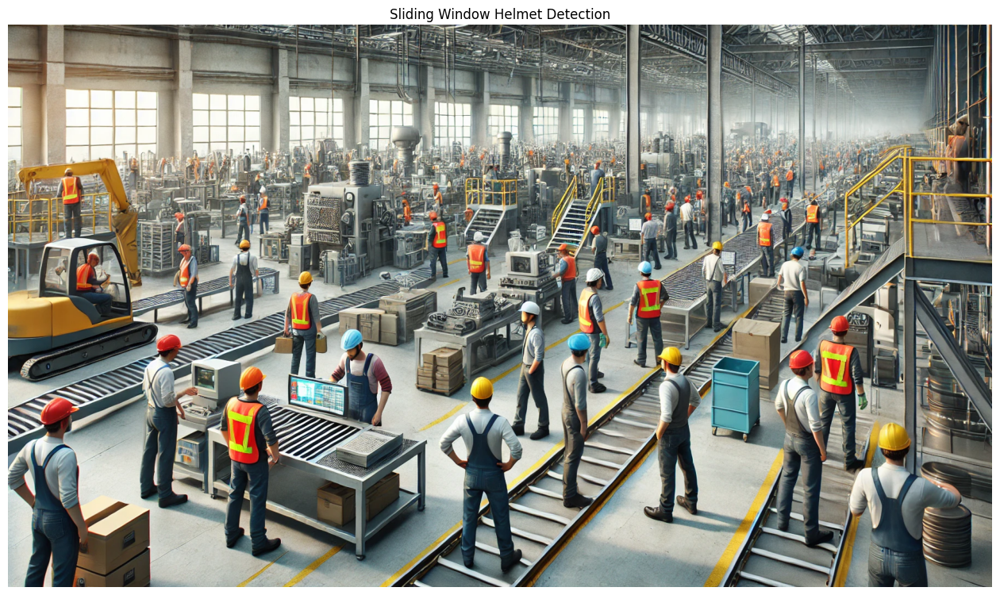

Detected Boxes: []


In [62]:
# Perform sliding window helmet detection
detected_boxes = sliding_window_detection(
    image_path=image_path,
    model=model,
    text_prompt="helmet",
    window_size=(224, 224),
    step_size=50
)

# Print detected boxes
print("Detected Boxes:", detected_boxes)


In [63]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

def sliding_window_detection(image_path, model, text_prompt, window_size=(224, 224), step_size=50, threshold=0.5):
    """
    Perform helmet detection using sliding windows and Grounding DINO.
    Args:
    - image_path (str): Path to the input image.
    - model: Pre-trained Grounding DINO model.
    - text_prompt (str): Text prompt for the Grounding DINO model.
    - window_size (tuple): Size of the sliding window (width, height).
    - step_size (int): Step size for sliding the window.
    - threshold (float): Confidence threshold for detections.

    Returns:
    - annotated_image (numpy array): Image with detected boxes drawn.
    - detected_boxes (list): List of detected bounding boxes and their confidences.
    """
    # Load the image
    image_source, image = load_image(image_path)
    original_image = image_source.copy()
    height, width = image.shape[:2]

    detected_boxes = []

    # Slide a window over the image
    for y in range(0, height - window_size[1] + 1, step_size):
        for x in range(0, width - window_size[0] + 1, step_size):
            # Extract the current window
            window = image[y:y + window_size[1], x:x + window_size[0]]

            # Perform prediction
            boxes, logits, phrases = predict(
                model=model,
                image=window,
                caption=text_prompt,
                box_threshold=threshold,
                text_threshold=0.25
            )

            # Adjust box coordinates to the original image scale
            for box in boxes:
                adjusted_box = [
                    box[0] + x, box[1] + y,
                    box[2] + x, box[3] + y
                ]
                detected_boxes.append((adjusted_box, logits[0]))

                # Draw the detected box on the original image
                cv2.rectangle(original_image,
                              (int(adjusted_box[0]), int(adjusted_box[1])),
                              (int(adjusted_box[2]), int(adjusted_box[3])),
                              (0, 255, 0), 2)

    # Plot the result
    plt.figure(figsize=(16, 16))
    plt.imshow(original_image)
    plt.axis("off")
    plt.title("Sliding Window Helmet Detection")
    plt.show()

    return original_image, detected_boxes


In [64]:
def batch_predict(patches, model, text_prompt, threshold=0.5):
    """Batch predict for all patches."""
    all_boxes = []
    for patch in patches:
        boxes, logits, phrases = predict(
            model=model,
            image=patch,
            caption=text_prompt,
            box_threshold=threshold,
            text_threshold=0.25
        )
        all_boxes.append((boxes, logits, phrases))
    return all_boxes


In [65]:
def non_max_suppression(boxes, scores, iou_threshold=0.5):
    """Perform Non-Maximum Suppression."""
    indices = cv2.dnn.NMSBoxes(
        boxes,
        scores,
        score_threshold=0.5,
        nms_threshold=iou_threshold
    )
    filtered_boxes = [boxes[i[0]] for i in indices]
    return filtered_boxes


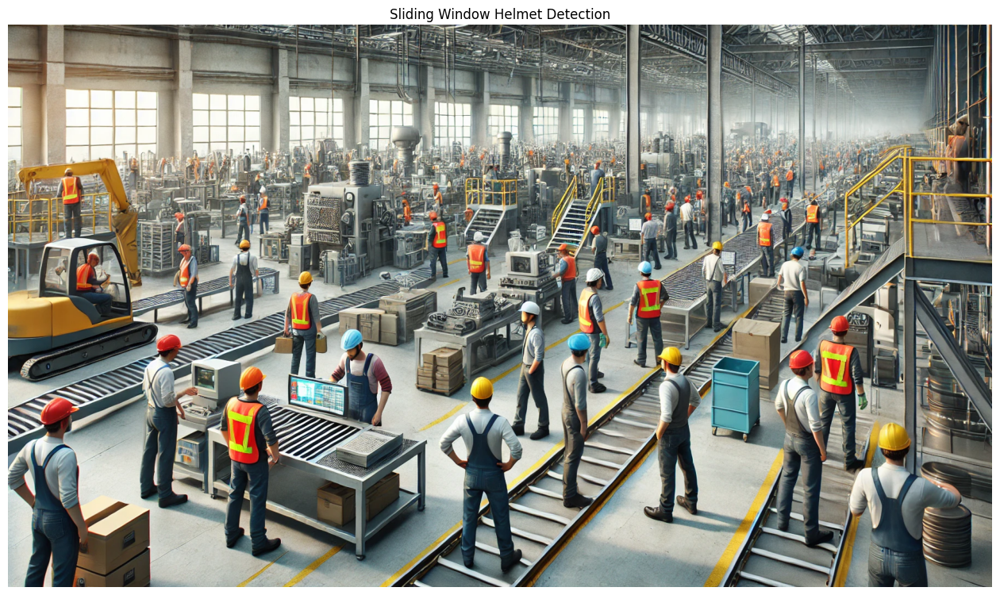

In [66]:
# Define the uploaded image path
image_path = "/content/factory.jpg"

# Run the improved sliding window detection
annotated_image, detected_boxes = sliding_window_detection(
    image_path=image_path,
    model=model,
    text_prompt="helmet",
    window_size=(224, 224),
    step_size=100,  # Larger step size for faster detection
    threshold=0.5
)

# Print detected boxes
for box, confidence in detected_boxes:
    print(f"Detected Box: {box}, Confidence: {confidence}")


final text_encoder_type: bert-base-uncased


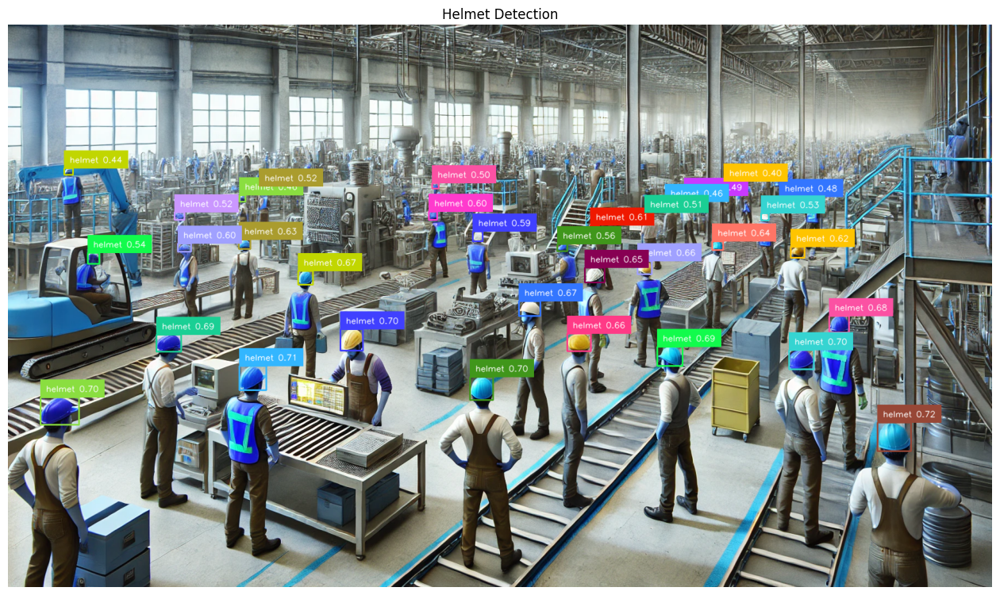

Detected: helmet at tensor([0.8447, 0.5326, 0.0198, 0.0293])
Detected: helmet at tensor([0.3492, 0.5604, 0.0226, 0.0385])
Detected: helmet at tensor([0.6472, 0.4322, 0.0147, 0.0238])
Detected: helmet at tensor([0.5300, 0.5046, 0.0215, 0.0265])
Detected: helmet at tensor([0.2489, 0.6287, 0.0272, 0.0431])
Detected: helmet at tensor([0.8062, 0.5954, 0.0251, 0.0341])
Detected: helmet at tensor([0.6725, 0.5899, 0.0257, 0.0348])
Detected: helmet at tensor([0.1636, 0.5662, 0.0250, 0.0307])
Detected: helmet at tensor([0.0528, 0.6872, 0.0395, 0.0492])
Detected: helmet at tensor([0.4814, 0.6469, 0.0233, 0.0409])
Detected: helmet at tensor([0.3023, 0.4499, 0.0150, 0.0243])
Detected: helmet at tensor([0.2404, 0.3908, 0.0115, 0.0171])
Detected: helmet at tensor([0.8024, 0.4046, 0.0136, 0.0198])
Detected: helmet at tensor([0.9008, 0.7333, 0.0338, 0.0507])
Detected: helmet at tensor([0.7214, 0.3931, 0.0109, 0.0157])
Detected: helmet at tensor([0.5964, 0.3653, 0.0092, 0.0159])
Detected: helmet at tens

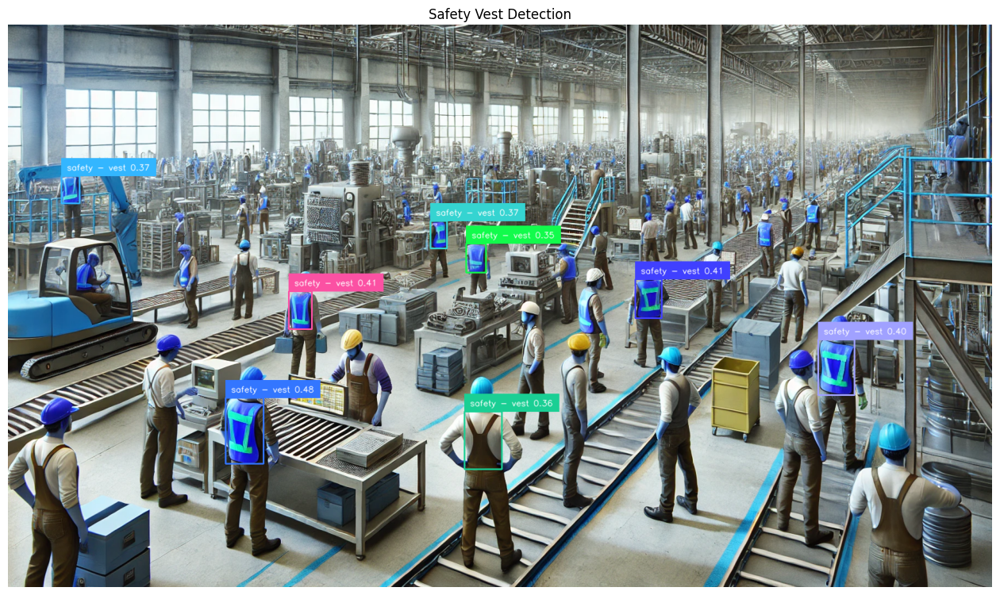

Detected: safety - vest at tensor([0.2971, 0.5082, 0.0231, 0.0674])
Detected: safety - vest at tensor([0.6509, 0.4875, 0.0271, 0.0699])
Detected: safety - vest at tensor([0.8417, 0.6090, 0.0369, 0.0985])
Detected: safety - vest at tensor([0.2403, 0.7221, 0.0384, 0.1171])
Detected: safety - vest at tensor([0.0636, 0.2939, 0.0185, 0.0487])
Detected: safety - vest at tensor([0.4379, 0.3734, 0.0164, 0.0494])
Detected: safety - vest at tensor([0.4756, 0.4153, 0.0202, 0.0518])
Detected: safety - vest at tensor([0.4830, 0.7391, 0.0384, 0.1031])


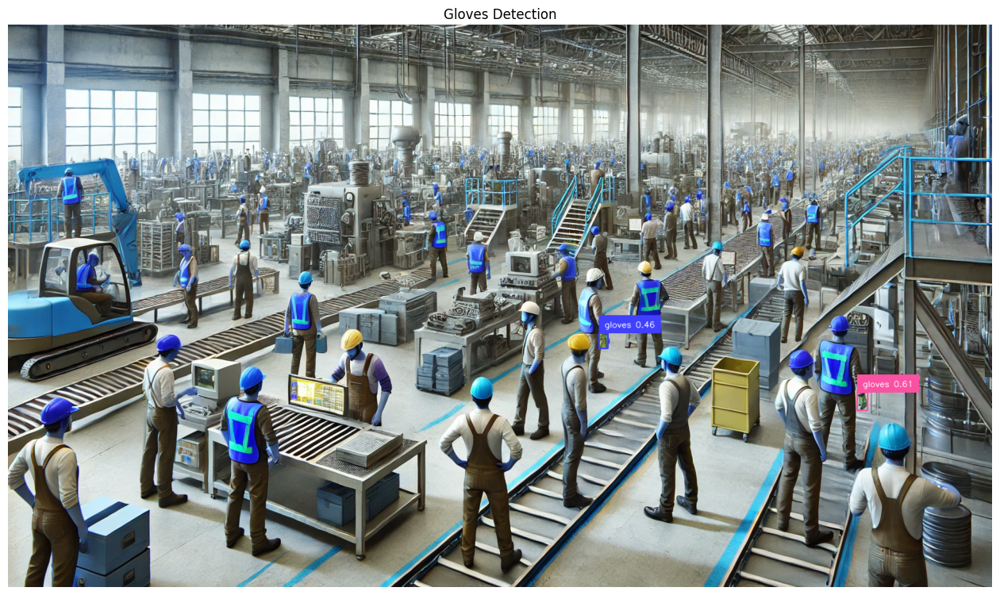

Detected: gloves at tensor([0.8685, 0.6698, 0.0107, 0.0317])
Detected: gloves at tensor([0.6053, 0.5620, 0.0093, 0.0281])


In [73]:
import os
import matplotlib.pyplot as plt
from groundingdino.util.inference import load_model, load_image, predict, annotate

# Define paths for configuration and weights
CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
WEIGHTS_PATH = os.path.join(HOME, "weights", "groundingdino_swint_ogc.pth")

# Load the Grounding DINO model
model = load_model(CONFIG_PATH, WEIGHTS_PATH)

# Detection settings
BOX_THRESHOLD = 0.35  # Detection confidence threshold for bounding boxes
TEXT_THRESHOLD = 0.25  # Text matching confidence threshold

def detect_and_plot(image_path, text_prompt, title):
    """
    Perform detection and plot the annotated image.
    Args:
        image_path (str): Path to the image file.
        text_prompt (str): The text prompt for detection (e.g., "helmet").
        title (str): Title of the plot (e.g., "Helmet Detection").
    """
    # Load the image
    image_source, image = load_image(image_path)

    # Perform prediction using Grounding DINO
    boxes, logits, phrases = predict(
        model=model,
        image=image,
        caption=text_prompt,
        box_threshold=BOX_THRESHOLD,
        text_threshold=TEXT_THRESHOLD
    )

    # Annotate the image with predictions
    annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

    # Plot the annotated image
    plt.figure(figsize=(16, 16))
    plt.imshow(annotated_frame)
    plt.axis("off")
    plt.title(title)
    plt.show()

    # Print detected phrases and their bounding boxes
    for phrase, box in zip(phrases, boxes):
        print(f"Detected: {phrase} at {box}")

# Path to the input image
image_path = "/content/factory.jpg"  # Replace with your input image path

# Detect and plot helmet
detect_and_plot(image_path, "helmet", "Helmet Detection")

# Detect and plot safety vest
detect_and_plot(image_path, "safety-vest", "Safety Vest Detection")

# Detect and plot gloves
detect_and_plot(image_path, "gloves", "Gloves Detection")


In [84]:
import cv2
import matplotlib.pyplot as plt
from groundingdino.util.inference import load_model, load_image, predict

# Detection settings
BOX_THRESHOLD = 0.35  # Detection confidence threshold for bounding boxes
TEXT_THRESHOLD = 0.25  # Text matching confidence threshold

# Define paths for configuration and weights
CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
WEIGHTS_PATH = os.path.join(HOME, "weights", "groundingdino_swint_ogc.pth")

# Load the Grounding DINO model
model = load_model(CONFIG_PATH, WEIGHTS_PATH)

def sliding_window(image, step_size, window_size):
    """
    Generate sliding window proposals.
    Args:
        image (numpy array): Input image.
        step_size (int): Step size for sliding the window.
        window_size (tuple): Size of the sliding window (width, height).
    Yields:
        (x, y, window): Coordinates and cropped window.
    """
    for y in range(0, image.shape[0] - window_size[1] + 1, step_size):
        for x in range(0, image.shape[1] - window_size[0] + 1, step_size):
            yield (x, y, image[y:y + window_size[1], x:x + window_size[0]])

def detect_with_sliding_window(image_path, text_prompt, title, window_size=(224, 224), step_size=32):
    """
    Perform object detection using the sliding window approach.
    Args:
        image_path (str): Path to the input image.
        text_prompt (str): Detection prompt (e.g., "helmet").
        title (str): Title for the plot.
        window_size (tuple): Size of the sliding window (width, height).
        step_size (int): Step size for sliding the window.
    """
    # Load the image
    image_source, image = load_image(image_path)
    original_image = cv2.cvtColor(image_source, cv2.COLOR_BGR2RGB)

    # Initialize list to store valid detections
    valid_boxes = []

    # Iterate through sliding window proposals
    for (x, y, window) in sliding_window(original_image, step_size, window_size):
        # Ensure the window size matches the expected input
        if window.shape[0] != window_size[1] or window.shape[1] != window_size[0]:
            continue

        # Resize the cropped window for the model input
        resized_window = cv2.resize(window, (224, 224))

        # Perform prediction on the cropped window
        boxes, logits, phrases = predict(
            model=model,
            image=resized_window,
            caption=text_prompt,
            box_threshold=BOX_THRESHOLD,
            text_threshold=TEXT_THRESHOLD,
        )

        # Adjust bounding boxes to the original coordinates
        for box in boxes:
            adjusted_box = [box[0] + x, box[1] + y, box[2] + x, box[3] + y]
            valid_boxes.append((adjusted_box, phrases[0], logits[0]))

    # Annotate the original image
    annotated_image = image_source.copy()
    for box, phrase, score in valid_boxes:
        x_min, y_min, x_max, y_max = map(int, box)
        label = f"{phrase} {score:.2f}"

        # Draw bounding box and label
        color = (0, 255, 0)
        cv2.rectangle(annotated_image, (x_min, y_min), (x_max, y_max), color, 2)
        cv2.putText(annotated_image, label, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Plot the annotated image
    plt.figure(figsize=(16, 16))
    plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title(title)
    plt.show()

# Path to the input image
image_path = "/content/factory.jpg"  # Replace with your input image path

# Perform detection using sliding window
detect_with_sliding_window(image_path, "helmet", "Helmet Detection")
detect_with_sliding_window(image_path, "safety-vest", "Safety Vest Detection")
detect_with_sliding_window(image_path, "gloves", "Gloves Detection")


final text_encoder_type: bert-base-uncased


AttributeError: 'numpy.ndarray' object has no attribute 'to'

## 🏆 Congratulations

### Learning Resources

Roboflow has produced many resources that you may find interesting as you advance your knowledge of computer vision:

- [Roboflow Notebooks](https://github.com/roboflow/notebooks): A repository of over 20 notebooks that walk through how to train custom models with a range of model types, from YOLOv7 to SegFormer.
- [Roboflow YouTube](https://www.youtube.com/c/Roboflow): Our library of videos featuring deep dives into the latest in computer vision, detailed tutorials that accompany our notebooks, and more.
- [Roboflow Discuss](https://discuss.roboflow.com/): Have a question about how to do something on Roboflow? Ask your question on our discussion forum.
- [Roboflow Models](https://roboflow.com): Learn about state-of-the-art models and their performance. Find links and tutorials to guide your learning.

### Convert data formats

Roboflow provides free utilities to convert data between dozens of popular computer vision formats. Check out [Roboflow Formats](https://roboflow.com/formats) to find tutorials on how to convert data between formats in a few clicks.

### Connect computer vision to your project logic

[Roboflow Templates](https://roboflow.com/templates) is a public gallery of code snippets that you can use to connect computer vision to your project logic. Code snippets range from sending emails after inference to measuring object distance between detections.